## Advanced Lane Finding - Brent Wylie
[![Udacity - Self-Driving Car NanoDegree](https://s3.amazonaws.com/udacity-sdc/github/shield-carnd.svg)](http://www.udacity.com/drive)

The Project
---

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


## 1.0 Preprocessing: Camera calibration

Using checkerboard images in ./camera_cal, I can determine the camera matrix and distortion coefficients to correct imperfections in the camera intrisic characteristics.

Code written using this Udacity-provided example code as a reference: https://github.com/udacity/CarND-Camera-Calibration

First cell will calculate objpoints<=>imgpoints mapping and the second cell will calculate the camera matrix and distortion coefficients, then use these to undistort camera images.

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt

nx = 9
ny = 6
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        #write_name = 'corners_found'+str(idx)+'.jpg'
        #cv2.imwrite(write_name, img)
        cv2.imshow('img', img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

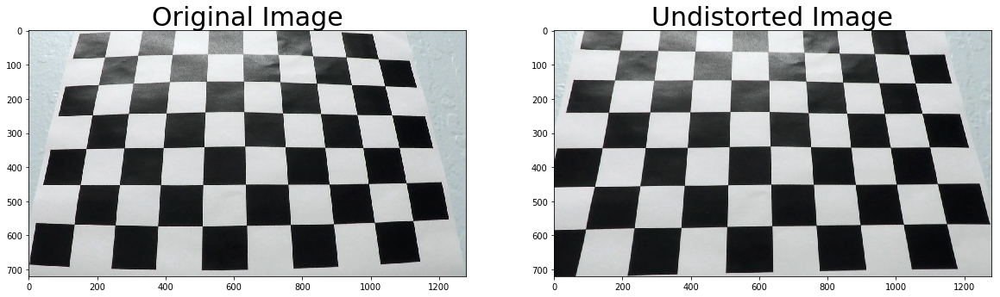

In [2]:
import pickle
%matplotlib inline

# Test undistortion on an image
img = cv2.imread('camera_cal/calibration3.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


dst = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('camera_cal/test_undist_cal3.jpg',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "camera_cal/cal_dist_params_pickle.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

## 2.0 Functions for preprocessing, thresholding, and transformation

In [3]:
###Utility functions (and imports)
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2

# Calculate directional gradient
# Lesson 21
def abs_sobel_thresholding(img, orientation='x', sobel_kernel=3, thresh=(0, 255)):
    # Apply x or y gradient
    if orientation == 'x':
        sobel = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif orientation == 'y':
        sobel = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Perform absolute value
    abs_sobel = np.absolute(sobel)
    # Normalize to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Apply threshold on new copy
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel > thresh[0]) & (scaled_sobel < thresh[1])] = 1
    return binary_output

# Calculate gradient magnitude
# Lesson 22
def mag_thresholding(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    # Return the binary image
    return binary_output

# Calculate gradient direction
# Lesson 23
def dir_thresholding(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Apply x and y gradients
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    dir_binary =  np.zeros_like(absgraddir)
    dir_binary[(absgraddir > thresh[0]) & (absgraddir < thresh[1])] = 1
    # Return the result
    return dir_binary

#Transform function
#Used for birds eye perspective transform
def transform(img):
    # Choose an offset from image corners to plot detected corners
    offset = 200 # offset for dst points x value
    # Grab the image shape
    img_size = (img.shape[1], img.shape[0])
    # Destination points are arbitrarily chosen
    src = np.float32([[578,458],[712,458],[1152,720],[148,720]])
    dst = np.float32([[offset, 0], 
                      [img_size[0]-offset, 0], 
                      [img_size[0]-offset, img_size[1]], 
                     [offset, img_size[1]]])
    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(img, M, img_size)
    # Return the resulting image and matrix
    return warped, M, Minv

print("STATUS: Utility functions defined, libraries successfully imported.")

STATUS: Utility functions defined, libraries successfully imported.


## 3.0 Testing undistort + transformation

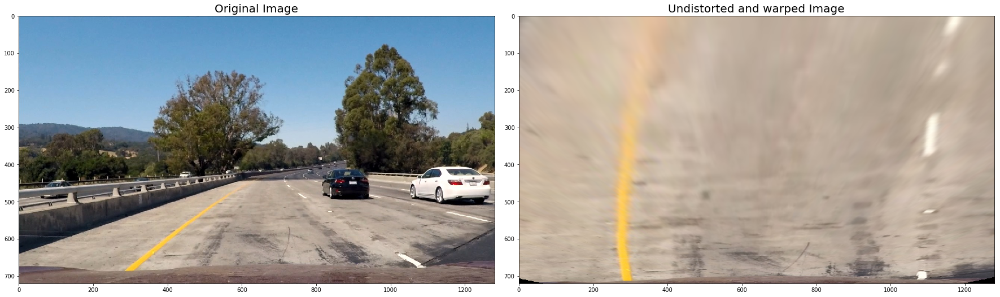

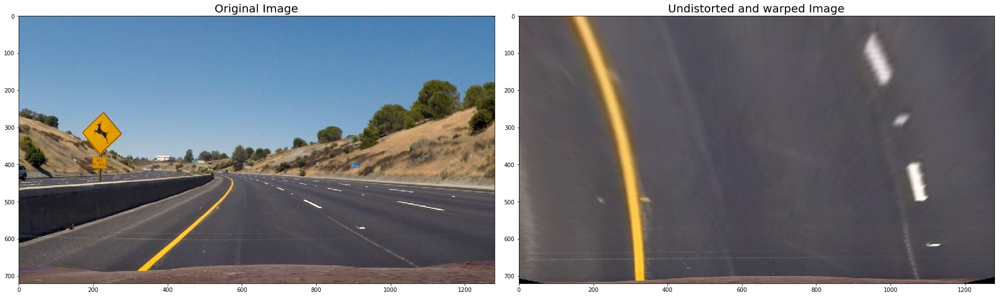

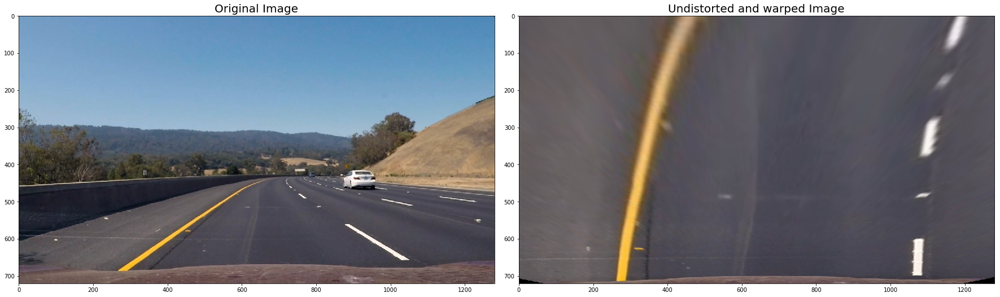

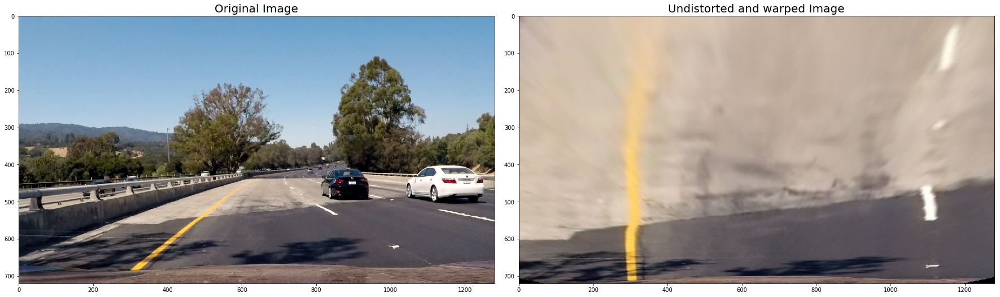

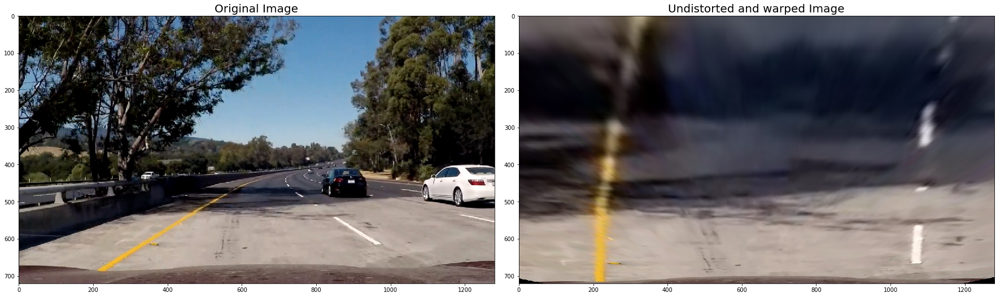

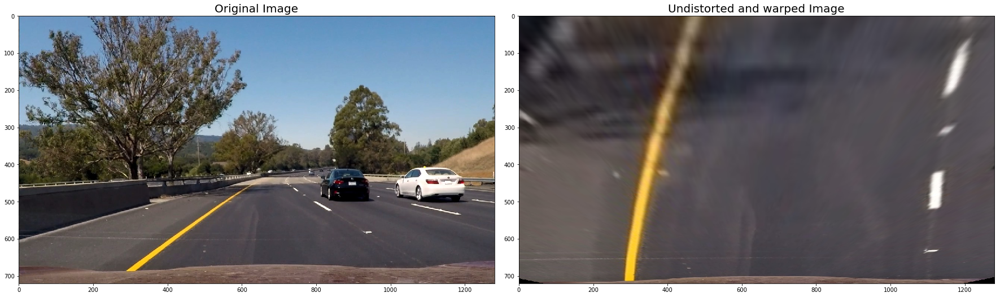

In [4]:
with open('camera_cal/cal_dist_params_pickle.p', 'rb') as f:
    dist_pickle = pickle.load(f)

for i in range(1,7):
    filename = 'test_images/test{}.jpg'.format(i)
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = (img.shape[1],img.shape[0])

    #Correct distortion
    uDst = cv2.undistort(img, dist_pickle["mtx"], dist_pickle["dist"], None,  dist_pickle["mtx"])

    warped, M, Minv = transform(uDst)
    
    #Plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(warped)
    ax2.set_title('Undistorted and warped Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## 3.1 Testing thresholding (pre-transformation)

In [5]:
def thresholding(img):
    # Gaussian blur to reduce noise
    kernel_size = 3
    img = cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)
    
    # Convert to HLS color  and extract S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s = hls[:,:,2]
    
    # Create Gray copy
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Define sobel kernel size
    sob_ksize = 3
    
    # Apply each of the thresholding functions
    gradx = abs_sobel_thresholding(gray, orientation='x', sobel_kernel=sob_ksize, thresh=(10, 255))
    grady = abs_sobel_thresholding(gray, orientation='y', sobel_kernel=sob_ksize, thresh=(60, 255))
    mag_binary = mag_thresholding(gray, sobel_kernel=sob_ksize, mag_thresh=(40, 255))
    dir_binary = dir_thresholding(gray, sobel_kernel=sob_ksize, thresh=(.65, 1.05))

    # Combine all the thresholded info
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    # Threshold S channel
    s_binary = np.zeros_like(combined)
    s_binary[(s > 160) & (s < 255)] = 1
     
    color_binary = np.zeros_like(combined)
    color_binary[(s_binary > 0) | (combined > 0)] = 1
    
    return color_binary


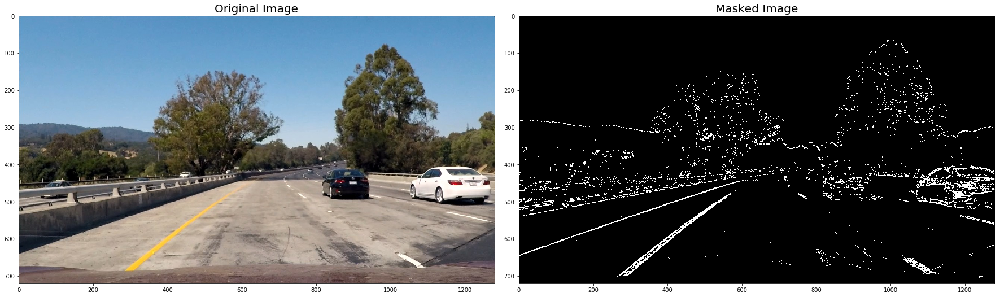

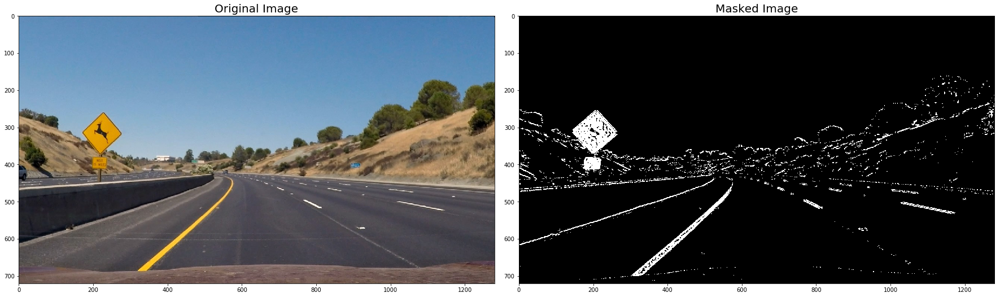

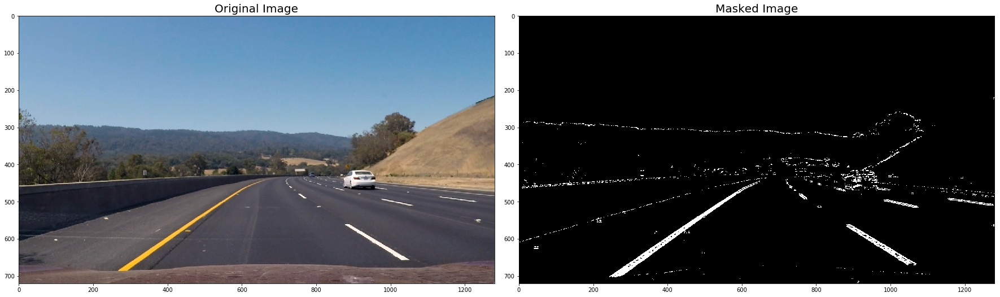

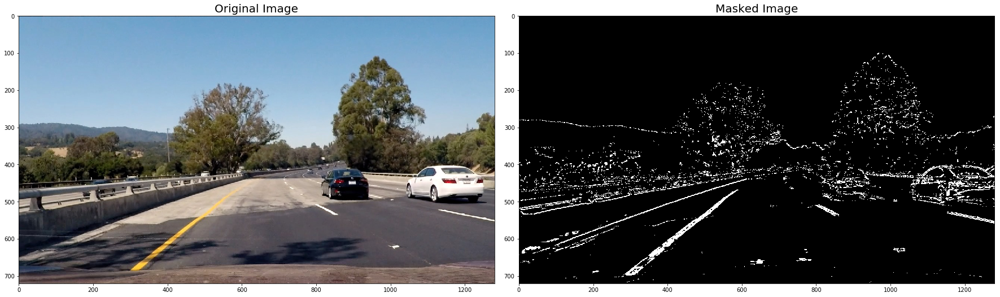

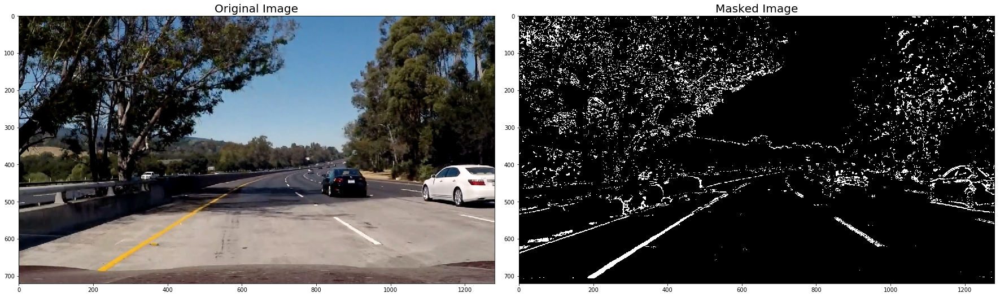

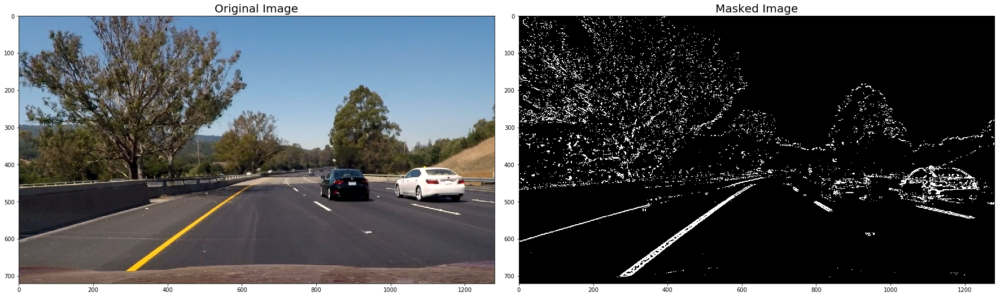

In [6]:
with open('camera_cal/cal_dist_params_pickle.p', 'rb') as f:
    dist_pickle = pickle.load(f)

for i in range(1,7):
    filename = 'test_images/test{}.jpg'.format(i)
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = (img.shape[1],img.shape[0])

    #Correct distortion
    uDst = cv2.undistort(img, dist_pickle["mtx"], dist_pickle["dist"], None,  dist_pickle["mtx"])

    color_binary = thresholding(uDst)

    #Plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(color_binary,cmap='gray')
    ax2.set_title('Masked Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## 3.2 Combining thresholding and transformation

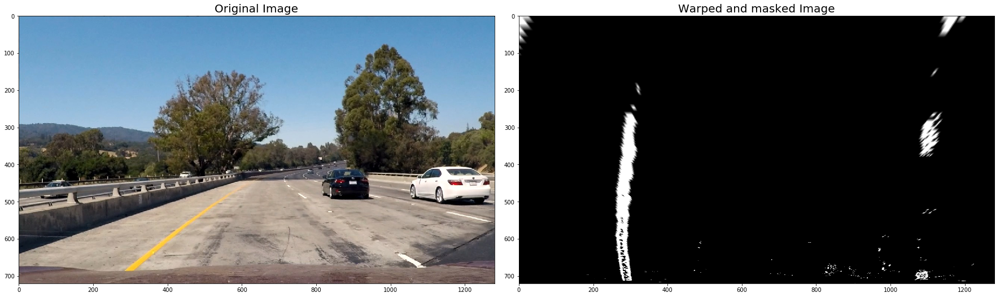

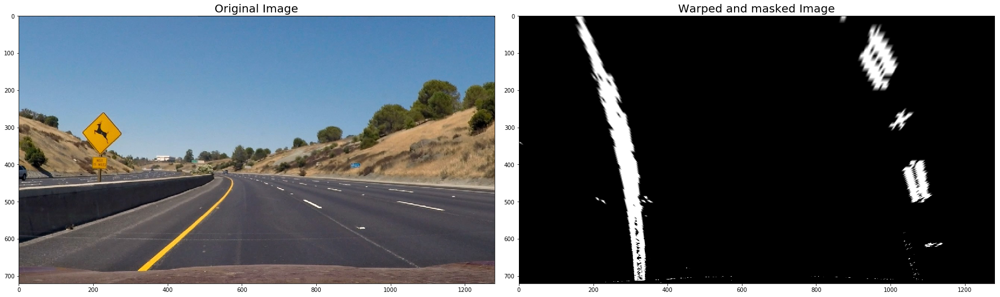

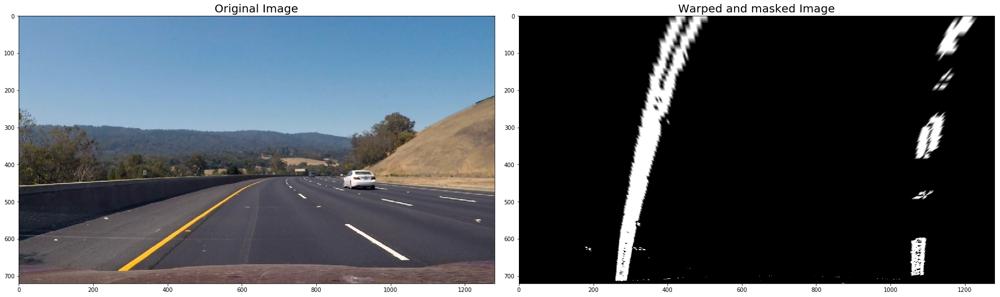

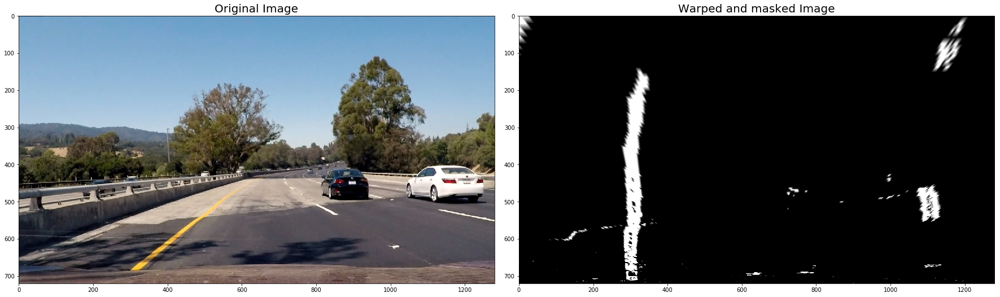

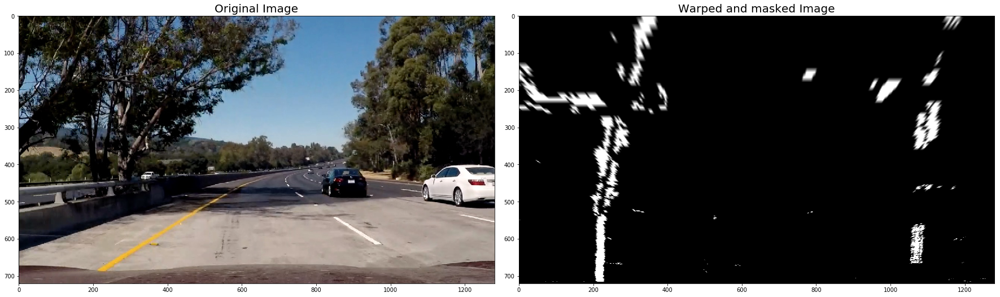

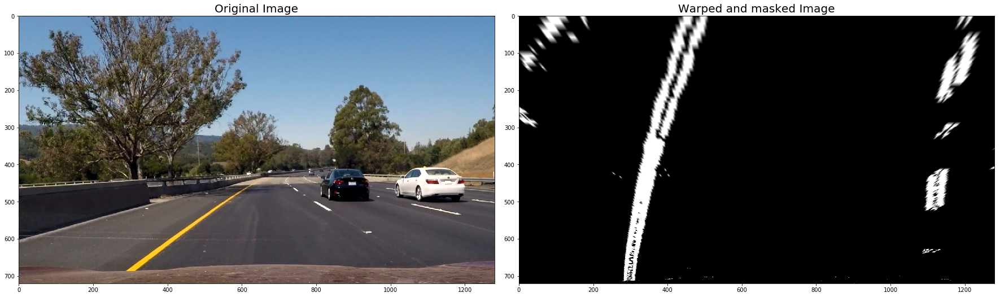

In [7]:
with open('camera_cal/cal_dist_params_pickle.p', 'rb') as f:
    dist_pickle = pickle.load(f)
    
for i in range(1,7):
    filename = 'test_images/test{}.jpg'.format(i)
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = (img.shape[1],img.shape[0])
    
    #Correct distortion
    uDst = cv2.undistort(img, dist_pickle["mtx"], dist_pickle["dist"], None,  dist_pickle["mtx"])
    color_bin = thresholding(uDst)
    warped, M, Minv = transform(color_bin)

    #Plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=20)
    ax2.imshow(warped, cmap='gray')
    ax2.set_title('Warped and masked Image', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## 4.0 Implementing Lane Detection and Curvature analysis

Now that I have test scripts written to tweak and optimize the perspective transform and edge detection algorithms, it's time to develop code for finding each lane line and determining the curvature of the lanes. 

In [19]:
# Define a class to receive the characteristics of each line detection
# Lesson 36
class Lane():
    def __init__(self):
        #Is detected?
        self.detected=False
        #FitX History
        self.fitx_hist=None
        
#Used to determine radius of curvature (in meters), takes y values and fit line (either left or right) as input
#Lesson 35
def find_curvature_old(yvals, linefitx):
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(yvals)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension
    fit_cr = np.polyfit(yvals*ym_per_pix, linefitx*xm_per_pix, 2)
    curve_radius = ((1 + (2*fit_cr[0]*y_eval + fit_cr[1])**2)**1.5)/np.absolute(2*fit_cr[0])
    return curve_radius

def find_curvature(y_eval, fit_cr):
    # Define y-value where we want radius of curvature
    # I'll choose the maximum y-value, corresponding to the bottom of the image
    # Define conversions in x and y from pixels space to meters
    curve_radius = ((1 + (2*fit_cr[0]*y_eval + fit_cr[1])**2)**1.5)/np.absolute(2*fit_cr[0])
    return curve_radius


def find_center_offset(left_fit, right_fit):
    xm_per_pix = 3.7/700 #meters per pixel in x dimension
    imHeight = 720
    imWidth = 1280 #hardcoding image size
    center_offset = ( (imWidth/2) - ((left_fit[0]*imHeight**2+left_fit[1]*imHeight+left_fit[2]) + \
        (right_fit[0]*imHeight**2+right_fit[1]*imHeight+right_fit[2]))/2)*xm_per_pix
    return center_offset

#Finds the lane lines using a sliding window search
#Lesson 33
def findlanes(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        #cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        #cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    #Conversions to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    y_eval = np.max(ploty) * ym_per_pix

    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Find curvatures
    #left_curve_radius  = find_curvature(ploty, left_fitx)
    #right_curve_radius = find_curvature(ploty, right_fitx)
    left_curve_radius = find_curvature(y_eval,left_fit_cr)
    right_curve_radius = find_curvature(y_eval,right_fit_cr)
    
    # Find offset from center
    center_offset = find_center_offset(left_fit,right_fit)
    
    return left_fitx, right_fitx, ploty,left_curve_radius,right_curve_radius, center_offset

C:\Users\b55321\AppData\Local\Continuum\Miniconda3\envs\carnd-term1\lib\site-packages\ipykernel\__main__.py:35: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


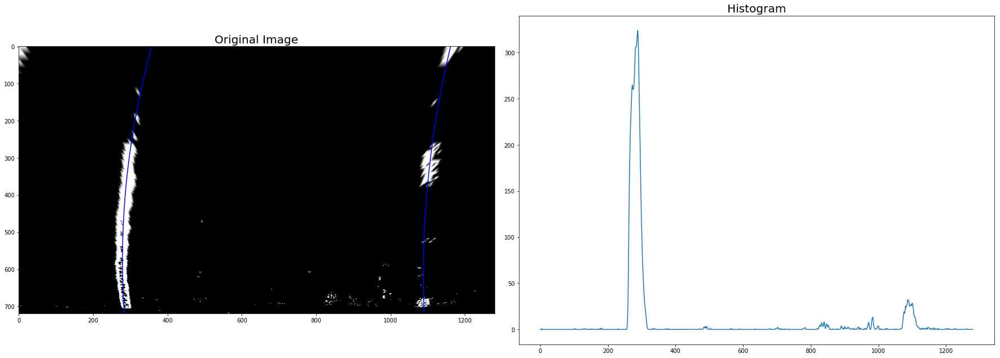

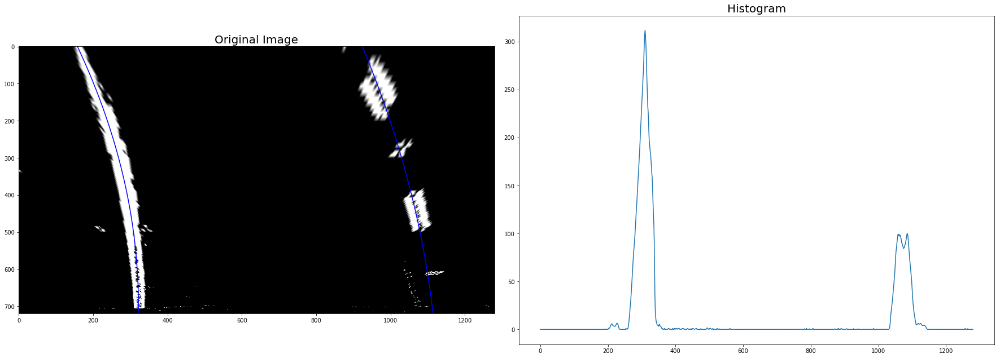

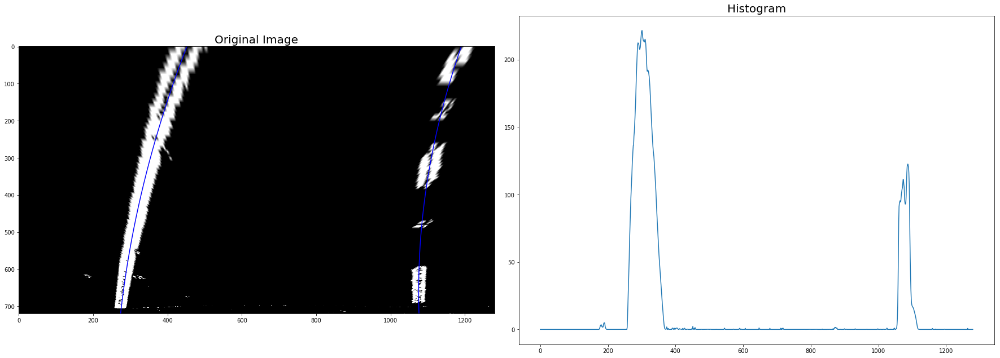

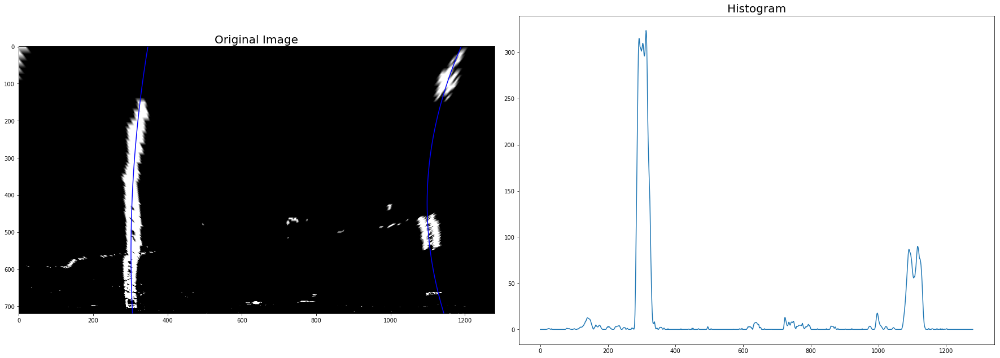

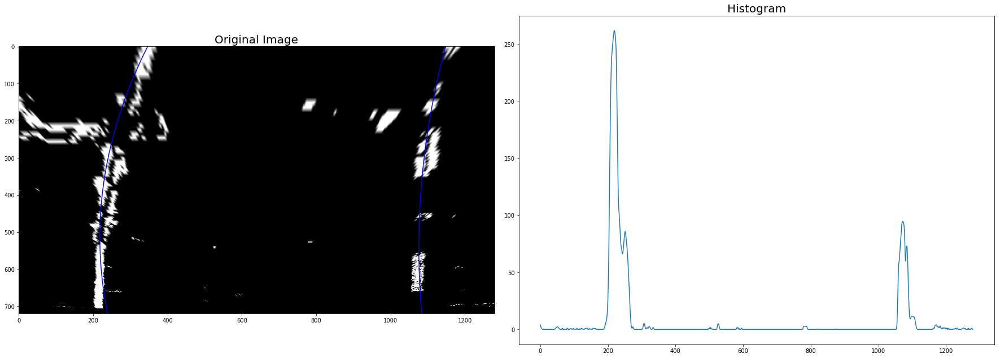

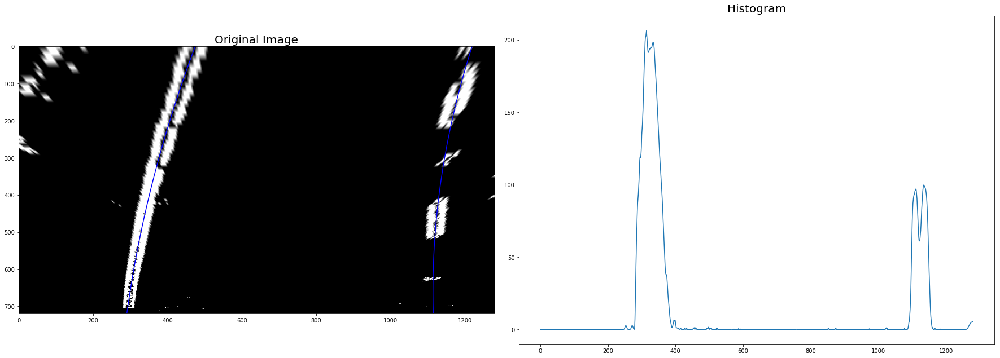

In [9]:
import numpy as np
import cv2
import glob
import pickle
import matplotlib.pyplot as plt
%matplotlib qt
%matplotlib inline
##Testing lane search on multiple images
with open('camera_cal/cal_dist_params_pickle.p', 'rb') as f:
    dist_pickle = pickle.load(f)
    
for i in range(1,7):
    filename = 'test_images/test{}.jpg'.format(i)
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = (img.shape[1],img.shape[0])
    
    #Correct distortion
    uDst = cv2.undistort(img, dist_pickle["mtx"], dist_pickle["dist"], None,  dist_pickle["mtx"])
    color_bin = thresholding(img)
    binary_warped, M, Minv = transform(color_bin)
    
    left_fitx, right_fitx,ploty,left_curve,right_curve,center_offset = findlanes(binary_warped)
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    #Plot
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(binary_warped, cmap='gray')
    ax1.plot(left_fitx, ploty, color='blue')
    ax1.plot(right_fitx, ploty, color='blue')
    ax1.set_title('Original Image', fontsize=20)
    ax2.plot(histogram)
    ax2.set_title('Histogram', fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
      

## 4.1 Testing Lane detection on static images
Now we have the lane equations and the curvature for each lane. Here we will define a function for drawing the lane areas on the original image. 

In [10]:
# Draw poly on an image
# Lesson 36
def draw_lane_area(img, left_fitx, right_fitx,Minv,curvature,center_offset):
    # Draw the polynomial
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0])
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(img[:,:,1]).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image 
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255,0))
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (color_warp.shape[1], color_warp.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
    
    # Add curvature and center offset text
    fontScale=1
    thickness=2
    fontFace = cv2.FONT_HERSHEY_SIMPLEX
    curve_txt = "Curvature: " + str(curvature) + ' m'
    center_offset_txt = "Center offset: " + str(center_offset)  + ' m'
    cv2.putText(result, curve_txt,(40,40),fontFace,fontScale,(255,255,255),thickness,lineType = cv2.LINE_AA)
    cv2.putText(result, center_offset_txt,(40,80),fontFace,fontScale,(255,255,255),thickness,lineType = cv2.LINE_AA)
    return result

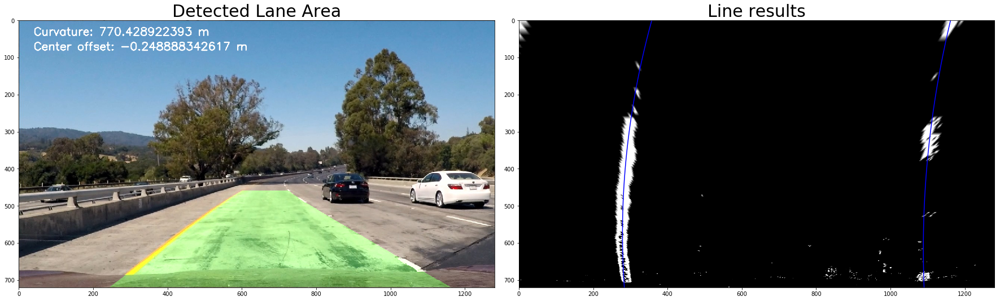

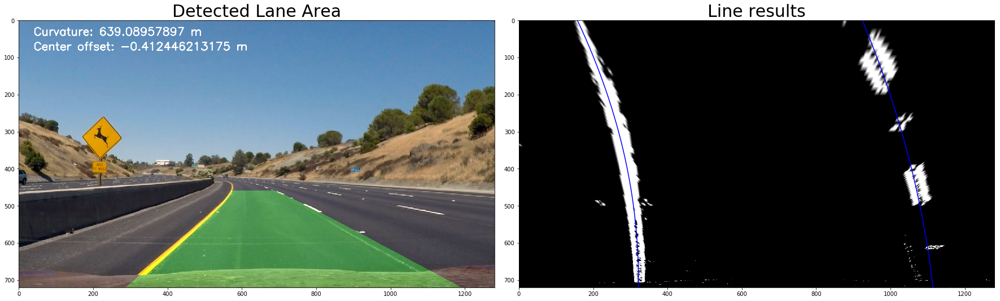

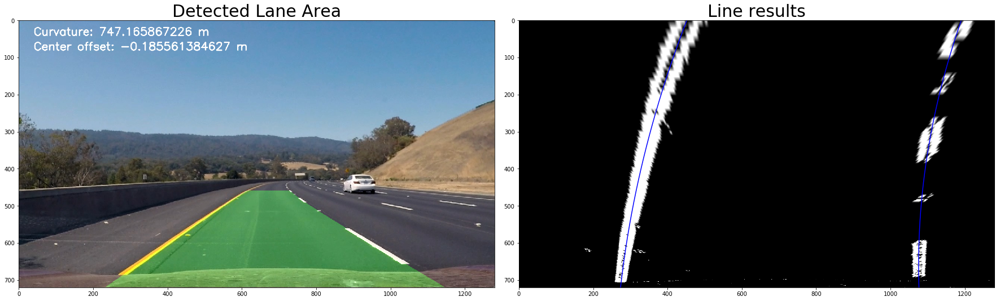

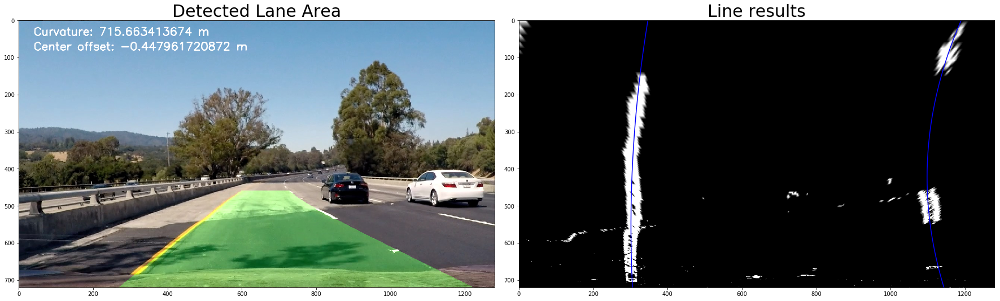

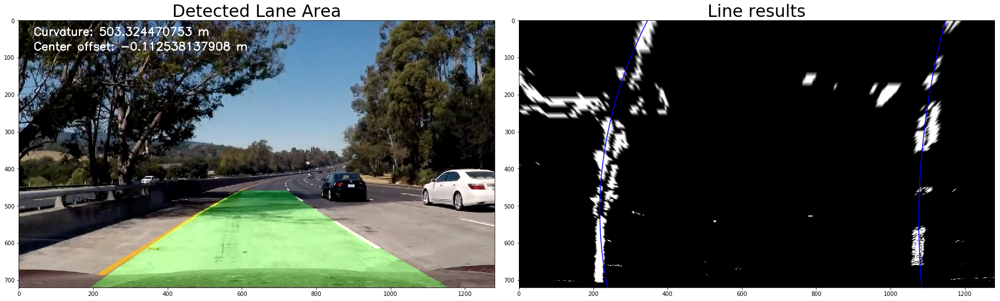

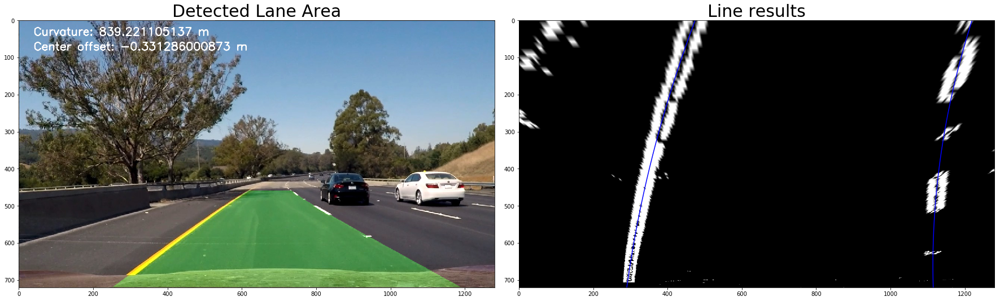

In [25]:
##Testing lane search on multiple images
with open('camera_cal/cal_dist_params_pickle.p', 'rb') as f:
    dist_pickle = pickle.load(f)
    
for i in range(1,7):
    filename = 'test_images/test{}.jpg'.format(i)
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_size = (img.shape[1],img.shape[0])
    
    #Correct distortion
    uDst = cv2.undistort(img, dist_pickle["mtx"], dist_pickle["dist"], None,  dist_pickle["mtx"])
    color_bin = thresholding(img)
    binary_warped, M, Minv = transform(color_bin)
    left_fitx,right_fitx,ploty,left_curve,right_curve,center_offset = findlanes(binary_warped)
    avg_curve = (left_curve + right_curve)/2
    new_img = draw_lane_area(img,left_fitx,right_fitx,Minv,avg_curve,center_offset)
    
    #Plot
    f, (ax1,ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(new_img)
    ax1.set_title('Detected Lane Area', fontsize=30)
    ax2.imshow(binary_warped, cmap='gray')
    ax2.plot(left_fitx, ploty, color='blue')
    ax2.plot(right_fitx, ploty, color='blue')
    ax2.set_title('Line results',fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## 5.0 Tracking implementation and video pipeline

In [26]:
#Sanity check function uses history to avg behavior
#Inspired by result in this thread: 
#https://discussions.udacity.com/t/lane-position-averaging-how-to-average-the-sliding-window-results/244682/3
def sanity_check_lanes(ploty,left_fitx,right_fitx):
    #Build left fit history in order to identify outliers
    if LeftLane.fitx_hist==None:
        LeftLane.fitx_hist=[]
        LeftLane.fitx_hist.append(left_fitx)
        #LeftLane.detected = True
    else:
        if abs((np.mean(np.mean(np.array(LeftLane.fitx_hist), axis=0 ))) - np.mean(left_fitx))<50:
            if len(LeftLane.fitx_hist)>5:
                LeftLane.fitx_hist=LeftLane.fitx_hist[1:]
            LeftLane.fitx_hist.append(left_fitx)
        else:
            RightLane.detected = False
    
    #Build right fit history in order to identify outliers
    if RightLane.fitx_hist==None:
        RightLane.fitx_hist=[]
        RightLane.fitx_hist.append(right_fitx)
        #RightLane.detected = True
    else:
        if abs((np.mean(np.mean(np.array(RightLane.fitx_hist), axis=0 ))) - np.mean(right_fitx))<50:
            if len(RightLane.fitx_hist)>5:
                RightLane.fitx_hist=RightLane.fitx_hist[1:]
            RightLane.fitx_hist.append(right_fitx)
        else:
            RightLane.detected = False
            
    left_fitx_mean = np.mean(np.array(LeftLane.fitx_hist), axis=0 )[:len(ploty)]
    right_fitx_mean = np.mean(np.array(RightLane.fitx_hist), axis=0 )[:len(ploty)]
    
    return left_fitx_mean, right_fitx_mean

#Func def for skipping the lane search when possible
def tracklanes(binary_warped):   
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Set the width of the windows +/- margin
    margin = 100
    
    if((LeftLane.detected==False)or(RightLane.detected==False)):
        # Assuming you have created a warped binary image called "binary_warped"
        # Take a histogram of the bottom half of the image
        histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
        # Create an output image to draw on and  visualize the result
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]/2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint
        # Choose the number of sliding windows
        nwindows = 9
        # Set height of windows
        window_height = np.int(binary_warped.shape[0]/nwindows)
        # Current positions to be updated for each window
        leftx_current = leftx_base
        rightx_current = rightx_base
        # Set minimum number of pixels found to recenter window
        minpix = 50
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []
        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
        
    else:
        # Assume you now have a new warped binary image 
        # from the next frame of video (also called "binary_warped")
        # It's now much easier to find line pixels!
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    #Conversions to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meteres per pixel in x dimension

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    y_eval = np.max(ploty) * ym_per_pix

    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Find curvatures
    #left_curve_radius  = find_curvature(ploty, left_fitx)
    #right_curve_radius = find_curvature(ploty, right_fitx)
    left_curve_radius = find_curvature(y_eval,left_fit_cr)
    right_curve_radius = find_curvature(y_eval,right_fit_cr)

    #Sanity check lines and create new lane classes
    left_fitx, right_fitx = sanity_check_lanes(ploty,left_fitx,right_fitx)

    # Find offset from center
    center_offset = find_center_offset(left_fit,right_fit)
 
    return left_fitx, right_fitx, left_curve_radius, right_curve_radius, center_offset

In [27]:
#Func def for creating video (without tracking)
def process_image(img):
    uDst = cv2.undistort(img, dist_pickle["mtx"], dist_pickle["dist"], None,  dist_pickle["mtx"])
    color_bin = thresholding(img)
    binary_warped, M, Minv = transform(color_bin)
    out_img, left_fitx, right_fitx,ploty,left_curve,right_curve = findlanes(binary_warped)
    return draw_lane_area(img,left_fitx,right_fitx,Minv)

In [28]:
#Func def for creating video (with tracking)
def process_image_with_tracking(img):
    uDst = cv2.undistort(img, dist_pickle["mtx"], dist_pickle["dist"], None,  dist_pickle["mtx"])
    color_bin = thresholding(img)
    binary_warped, M, Minv = transform(color_bin)
    leftFitX, rightFitX,left_curve,right_curve,center_offset = tracklanes(binary_warped) #Reads global variables LeftLane,RightLane
    avg_curve = (left_curve + right_curve)/2
    return draw_lane_area(img,leftFitX,rightFitX,Minv,avg_curve,center_offset)

In [29]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

LeftLane = Lane()
RightLane = Lane()

project_output = 'project_video_output_curvefix.mp4'
clip = VideoFileClip("project_video.mp4")
output_clip = clip.fl_image(process_image_with_tracking)
%time output_clip.write_videofile(project_output, audio=False)

HTML("""
<video  width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

[MoviePy] >>>> Building video project_video_output_curvefix.mp4
[MoviePy] Writing video project_video_output_curvefix.mp4


100%|█████████▉| 1260/1261 [05:27<00:00,  4.06it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output_curvefix.mp4 

Wall time: 5min 28s
